In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
import csv
import math
import numpy as np
import dtale
import pandas_profiling
import sweetviz as sv
import datetime as dt
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules
from sklearn.cluster import KMeans
from sklearn.feature_selection import SelectKBest, chi2, f_regression, f_classif
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.naive_bayes import GaussianNB
from matplotlib.ticker import MultipleLocator as ML
from matplotlib.ticker import ScalarFormatter as SF
from functools import reduce
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from keras.models import Sequential
from keras.layers import Dense, BatchNormalization, Dropout
from tensorflow.keras.optimizers import Adam, SGD, RMSprop, Adadelta, Adagrad, Adamax, Nadam, Ftrl
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.wrappers.scikit_learn import KerasClassifier
from math import floor
from sklearn.metrics import make_scorer, accuracy_score
from bayes_opt import BayesianOptimization
from sklearn.model_selection import StratifiedKFold
from keras.layers import LeakyReLU
LeakyReLU = LeakyReLU(alpha=0.1)
import warnings
warnings.filterwarnings('ignore')
pd.set_option("display.max_columns", None)
import random

# Functions

In [2]:
def data_clean(dataframe):
    # Reading dataset
    dataframe=pd.read_csv(dataframe)
    # filtering useful columns
    dataframe=dataframe.filter(['JD', 'Magnitude', 'Uncertainty'])
    # imputing interpolated values at Nan locations
    dataframe["Uncertainty"].interpolate(method = 'linear', inplace = True)
    dataframe["Uncertainty"] = dataframe.groupby('Magnitude')["Uncertainty"].ffill().bfill()
    # removing strings located within the rows < >
    dataframe["Magnitude"] = dataframe["Magnitude"].str.replace('\<','')
    dataframe["Magnitude"] = dataframe["Magnitude"].str.replace('\>','')
    # converting the data type to float from object
    dataframe["Magnitude"] = dataframe["Magnitude"].astype(float)
    return dataframe

In [3]:
def col_JD(dataframe):
    dataframe=dataframe.iloc[:,0].values
    return dataframe
def col_Mag(dataframe):
    dataframe=dataframe.iloc[:,1].values
    return dataframe

In [4]:
def filter1(dataframe,ranges):
    dataframe=dataframe[(dataframe["JD"]>=ranges)]
    return dataframe
def filter2(dataframe,ranges,ranges1):
    dataframe=dataframe[(dataframe["JD"]>=ranges) & (dataframe["JD"]<=ranges1)]
    return dataframe   

In [5]:
def phase(dataframe,number):
    dataframe.filter(['JD', 'Magnitude', 'Uncertainty'])
    dataframe.reset_index()
    dataframe["Difference in days Tn - Tn-1 "]=dataframe['JD'].diff()
    dataframe["Difference in days"]=dataframe['JD'].values-dataframe['JD'].iloc[0]
    dataframe['Cycles'] = dataframe['Difference in days']/number
    dataframe["Phase"] = dataframe['Cycles'] % 1
    dataframe = dataframe.fillna(0)
    return dataframe

In [6]:
def Sumx(dataframe):
    dataframe["Magnitude_Avg"]=(dataframe["Magnitude_x"]+dataframe["Magnitude_y"])/2
    dataframe["Uncertainty_Avg"]=(dataframe["Uncertainty_x"]+dataframe["Uncertainty_y"])/2
    dataframe=dataframe.filter(["JD","Magnitude_Avg","Uncertainty_Avg"])
    return dataframe

In [7]:
def Sumy(dataframe):
    dataframe["Magnitude_sum"]=dataframe["Magnitude_x"]+dataframe["Magnitude_y"]
    dataframe["Uncertainty_sum"]=dataframe["Uncertainty_x"]+dataframe["Uncertainty_y"]
    dataframe=dataframe.filter(["JD","Magnitude_Avg","Uncertainty_Avg"])
    return dataframe

In [8]:
def quant(dataframe):
    for i,j in enumerate(dataframe["Magnitude"]):
        if j >= np.quantile(dataframe["Magnitude"],0.90):# dimmest
            dataframe.at[i,"Pulsation State"]= 1
        if j <= np.quantile(dataframe["Magnitude"],0.10): #brightest
            dataframe.at[i,"Pulsation State"]= 1 
        else:
            continue
    dataframe["Pulsation State"] = dataframe["Pulsation State"].fillna(0) # Quasi equillibrium state
    return dataframe

In [9]:
def quant1(dataframe):
    for i,j in enumerate(dataframe["Magnitude"]):
        if j >= np.quantile(dataframe["Magnitude"],0.90):# dimmest
            dataframe.at[i,"State"]= 'Maxima/Minima'
        if j <= np.quantile(dataframe["Magnitude"],0.10): #brightest
            dataframe.at[i,"State"]= 'Maxima/Minima' 
        else:
            continue
    dataframe["State"] = dataframe["State"].fillna('Quasi equillibrium') # Quasi equillibrium state
    return dataframe

# DataFrames

In [10]:
dfMira=data_clean('mira.csv')
dfUori=data_clean('Uori.csv')
dfChi=data_clean('Chi Cyg.csv')
dfAnd=data_clean("R Andromedae.csv")
dfMira["Uncertainty"]

0        0.002
1        0.002
2        0.002
3        0.002
4        0.002
         ...  
80801    0.130
80802    0.130
80803    0.130
80804    0.130
80805    0.130
Name: Uncertainty, Length: 80806, dtype: float64

In [11]:
#dfMira["Uncertainty"]=dfMira.fillna(dfMira["Uncertainty"].interpolate(method = 'linear', inplace = True))

In [12]:
#dfMira["Uncertainty"]=dfMira.fillna(dfMira["Uncertainty"].interpolate(method = 'linear', inplace = True))

In [13]:
#dfMira.isnull().sum()

In [14]:
dfMiraTables=pd.read_excel("Mira Tables.xlsx")
dfMiraTables

,Star,Brightness(Mag),Dimmest(Mag),Periods(days)
0,Mira,2.0,10.1,332
1,Chi Cygni,3.3,14.2,408
2,R Hydrae,3.5,10.9,380
3,R Carinae,3.9,10.5,307
4,R Leonis,4.4,11.3,310
...,...,...,...,...
71,R Capricorni[19],8.9,14.9,343
72,UX Cygni,9.0,17.0,569
73,TY Cassiopeiae,10.1,19.0,645
74,IK Tauri,10.8,16.5,470


In [15]:
dfMira.columns

Index(['JD', 'Magnitude', 'Uncertainty'], dtype='object')

In [16]:
dfMira.dtypes

JD             float64
Magnitude      float64
Uncertainty    float64
dtype: object

# Null Values

In [17]:
dfMira.isnull().any()

JD             False
Magnitude      False
Uncertainty    False
dtype: bool

In [18]:
dfMira.isnull().sum()

JD             0
Magnitude      0
Uncertainty    0
dtype: int64

In [19]:
len(dfMira["Uncertainty"].unique())

32793

In [20]:
dfMira["Uncertainty"].value_counts()

0.002000    31248
0.030000     7083
0.020000     5060
0.040000      389
0.050000      161
            ...  
0.034707        1
0.034706        1
0.034706        1
0.034705        1
0.124000        1
Name: Uncertainty, Length: 32793, dtype: int64

# Exploration Mira Varaibles

In [21]:
JDMira=col_JD(dfMira)
JDUori=col_JD(dfUori)
JDChi=col_JD(dfChi)
JDAnd=col_JD(dfAnd)
MagMira=col_Mag(dfMira)
MagUori=col_Mag(dfUori)
MagChi=col_Mag(dfChi)
MagAnd=col_Mag(dfAnd)

In [22]:
print(MagMira)
print(MagUori)
print(MagChi)
print(MagAnd)

[2.8 3.5 3.5 ... 7.  6.5 6.5]
[6.31 6.11 9.04 ... 6.3  6.3  6.3 ]
[4.8 4.8 5.5 ... 7.7 7.9 7.7]
[10.7 10.   9.8 ... 11.5 11.8 12.7]


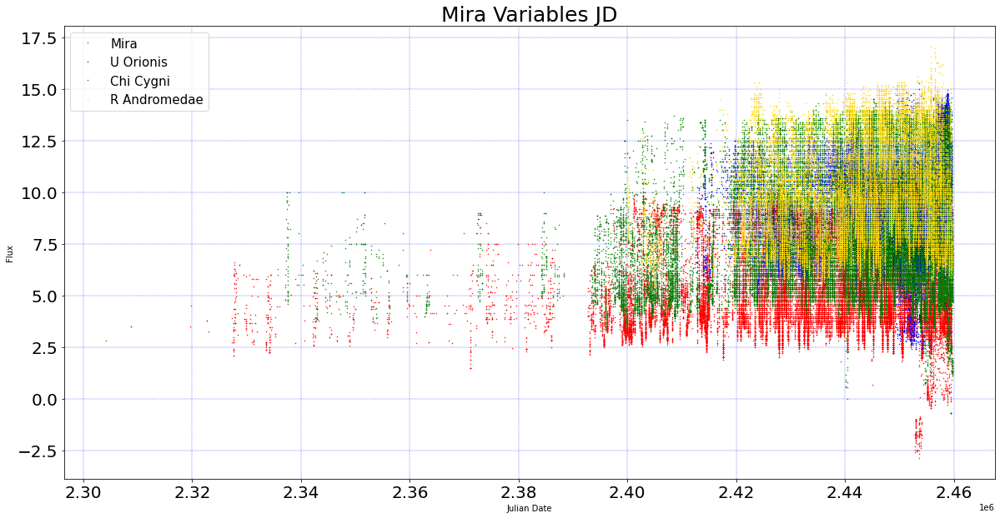

In [23]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.figure(figsize=(20, 10))
display(plt.plot(JDMira,MagMira,'k.',label="Mira", markersize=1,color="red"))
display(plt.plot(JDUori,MagUori,'k.',label="U Orionis", markersize=1, color="blue"))
display(plt.plot(JDChi,MagChi,'k.',label="Chi Cygni", markersize=1, color="green"))
display(plt.plot(JDAnd,MagAnd,'k.',label="R Andromedae", markersize=1, color="gold"))
plt.legend(loc="upper left",fontsize=15)
plt.xlabel('Julian Date')
plt.ylabel('Flux')
plt.title("Mira Variables JD", fontsize=25)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.grid(color='b', ls = '-.', lw = 0.3)
plt.show()

## Filter range 2420000 

In [24]:
newdfMira=filter1(dfMira,2420000)
newdfUori=filter1(dfUori,2420000)
newdfChi=filter1(dfChi,2420000)
newdfAnd=filter1(dfAnd,2420000)

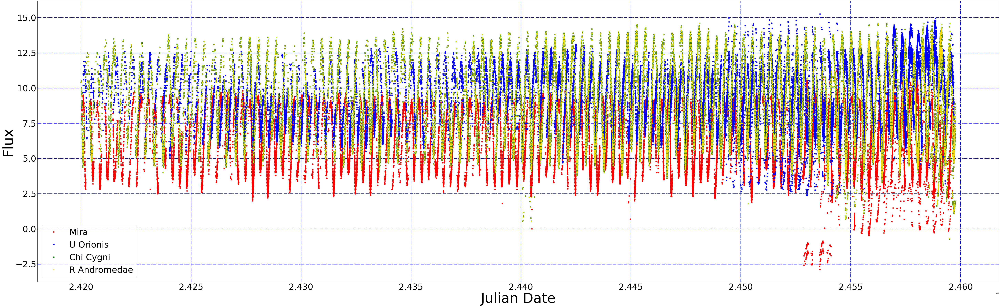

In [25]:
%matplotlib inline
plt.figure(figsize=(100, 30))
plt.plot(newdfMira["JD"],newdfMira["Magnitude"], 'k.',label="Mira", markersize=15, color="red")
plt.plot(newdfUori["JD"],newdfUori["Magnitude"], 'k.',label="U Orionis", markersize=15, color="blue")
plt.plot(newdfChi["JD"],newdfChi["Magnitude"], 'k.',label="Chi Cygni", markersize=15, color="green")
plt.plot(newdfChi["JD"],newdfChi["Magnitude"], 'k.',label="R Andromedae", markersize=10, color="gold")
plt.legend(loc="lower left",fontsize=50)
plt.xlabel('Julian Date',fontsize=80)
plt.ylabel('Flux',fontsize=80)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

## Filter range 2440000 

In [26]:
newdfMiraa=filter1(dfMira,2440000)
newdfUorii=filter1(dfUori,2440000)
newdfChii=filter1(dfChi,2440000)
newdfAnd=filter1(dfAnd,2440000)

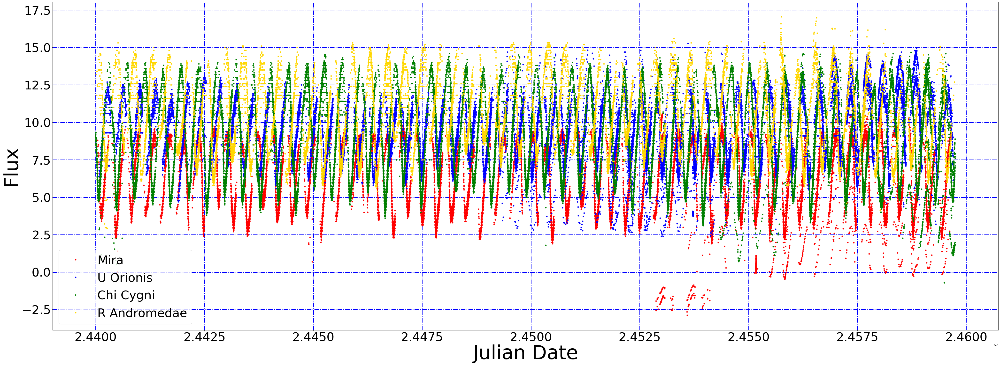

In [27]:
%matplotlib inline
plt.figure(figsize=(70, 25))
plt.plot(newdfMiraa["JD"],newdfMiraa["Magnitude"], 'k.',label="Mira", markersize=10,color="red")
plt.plot(newdfUorii["JD"],newdfUorii["Magnitude"], 'k.',label="U Orionis", markersize=10, color="blue")
plt.plot(newdfChii["JD"],newdfChii["Magnitude"], 'k.', label="Chi Cygni", markersize=10, color="green")
plt.plot(newdfAnd["JD"],newdfAnd["Magnitude"], 'k.', label="R Andromedae", markersize=10, color="gold")
plt.legend(loc="lower left",fontsize=50)
plt.xlabel('Julian Date',fontsize=80)
plt.ylabel('Flux',fontsize=80)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

## Filter range from 2440000 to 2442500

In [28]:
newdfMiraa=filter2(dfMira,2440000,2442500)
newdfUorii=filter2(dfUori,2440000,2442500)
newdfChii=filter2(dfChi,2440000,2442500)
newdfAndd=filter2(dfAnd,2440000,2442500)

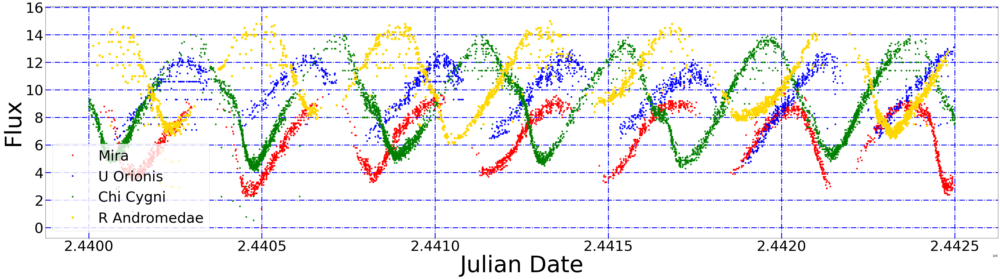

In [29]:
%matplotlib inline
plt.figure(figsize=(60, 15))
plt.plot(newdfMiraa["JD"],newdfMiraa["Magnitude"], 'k.',label="Mira", markersize=10, color="red")
plt.plot(newdfUorii["JD"],newdfUorii["Magnitude"], 'k.',label="U Orionis", markersize=10, color="blue")
plt.plot(newdfChii["JD"],newdfChii["Magnitude"], 'k.', label="Chi Cygni", markersize=10, color="green")
plt.plot(newdfAndd["JD"],newdfAndd["Magnitude"], 'k.', label="R Andromedae", markersize=15, color="gold")
plt.legend(loc="lower left",fontsize=50)
plt.xlabel('Julian Date',fontsize=80)
plt.ylabel('Flux',fontsize=80)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

# Filter range from 2459000 to 2460000 

In [30]:
newdfMiraa1=filter2(dfMira,2459000,2461000)
newdfUorii1=filter2(dfUori,2459000,2461000)
newdfChii1=filter2(dfChi,2459000,2461000)
newdfAndd1=filter2(dfAnd,2459000,2461000)

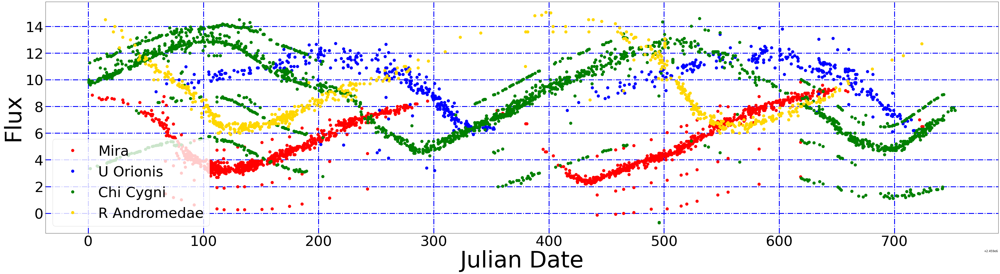

In [31]:
%matplotlib inline
plt.figure(figsize=(60, 15))
plt.plot(newdfMiraa1["JD"],newdfMiraa1["Magnitude"], 'k.',label="Mira", markersize=20, color="red")
plt.plot(newdfUorii1["JD"],newdfUorii1["Magnitude"], 'k.',label="U Orionis", markersize=20, color="blue")
plt.plot(newdfChii1["JD"],newdfChii1["Magnitude"], 'k.', label="Chi Cygni", markersize=20, color="green")
plt.plot(newdfAndd1["JD"],newdfAndd1["Magnitude"], 'k.', label="R Andromedae", markersize=20, color="gold")
plt.legend(loc="lower left",fontsize=50)
plt.xlabel('Julian Date',fontsize=80)
plt.ylabel('Flux',fontsize=80)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

## PHASE AND CYCLES MIRA

In [32]:
# for Mira period is 332
# for Uori period is 372.4 
# for Chi Cygni period is 408
# for R Andromedea period is 409

In [33]:
newdfMirap=phase(dfMira,332)
newdfUorii=phase(dfUori,372.4)
newdfChii=phase(dfChi,408)
newdfAndd=phase(dfAnd,409)

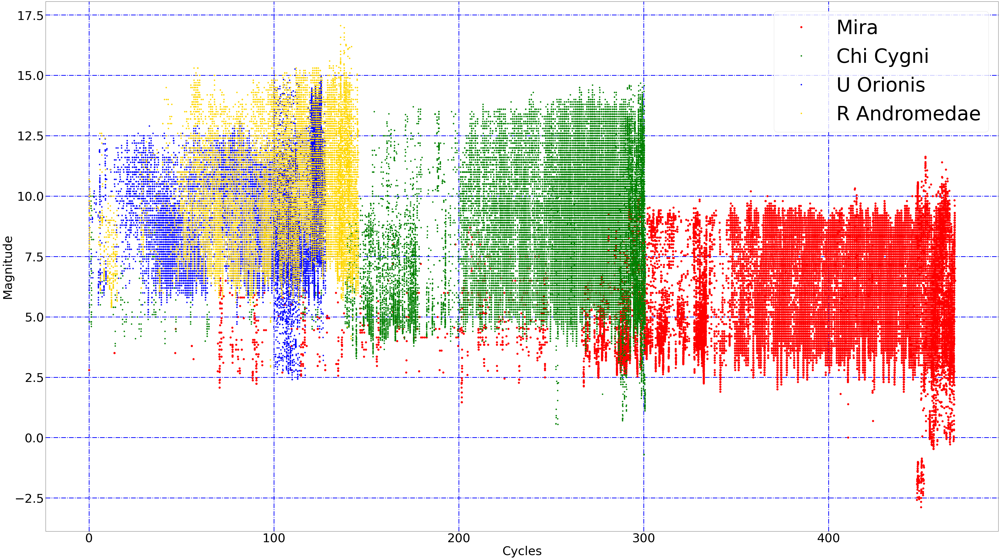

In [34]:
%matplotlib inline
plt.figure(figsize=(70, 40))
plt.plot(newdfMirap["Cycles"],newdfMirap["Magnitude"], 'k.',label="Mira", markersize=15,color="red")
plt.plot(newdfChii["Cycles"],newdfChii["Magnitude"], 'k.', label="Chi Cygni", markersize=10, color="green")
plt.plot(newdfUorii["Cycles"],newdfUorii["Magnitude"], 'k.', label="U Orionis", markersize=10, color="blue")
plt.plot(newdfAndd["Cycles"],newdfAndd["Magnitude"], 'k.', label="R Andromedae", markersize=10, color="gold")
plt.legend(loc="upper right",fontsize=80)
plt.xlabel('Cycles',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

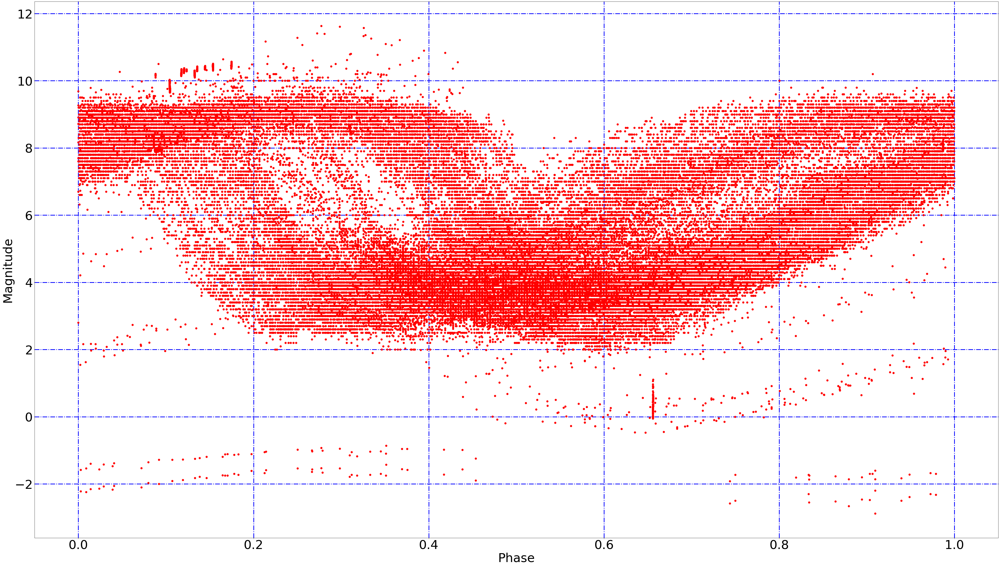

In [35]:
%matplotlib inline
plt.figure(figsize=(70, 40))
plt.plot(newdfMirap["Phase"],newdfMirap["Magnitude"], 'k.', markersize=15, color="red")
#plt.plot(newdfUorii["Phase"],newdfUorii["Magnitude"], 'k.', markersize=10, color="blue")
plt.xlabel('Phase',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

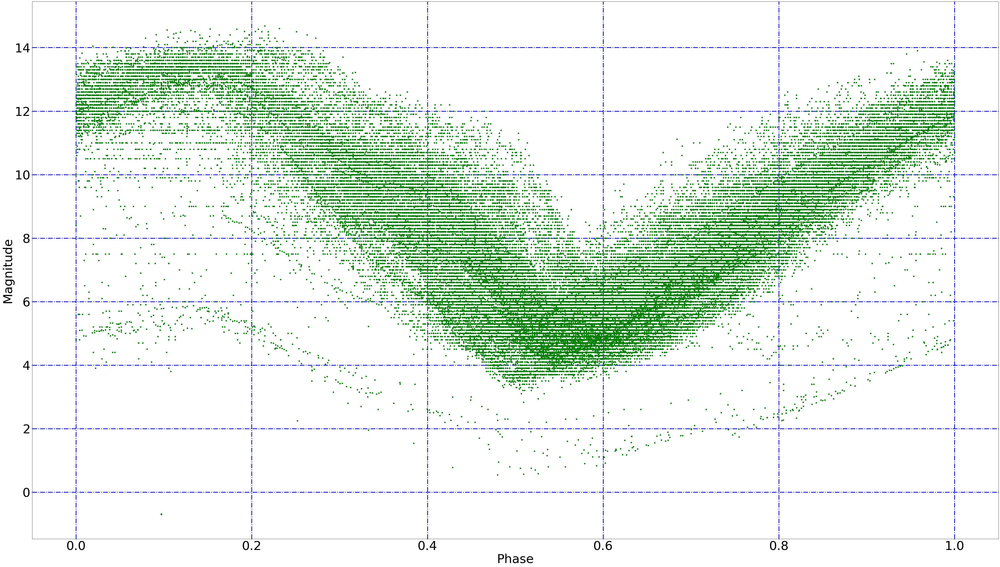

In [36]:
%matplotlib inline
plt.figure(figsize=(70, 40))
#plt.plot(newdfMirap["Phase"],newdfMirap["Magnitude"], 'k.', markersize=15)
#plt.plot(newdfUorii["Phase"],newdfUorii["Magnitude"], 'k.', markersize=10, color="blue")
plt.plot(newdfChii["Phase"],newdfChii["Magnitude"], 'k.', markersize=10, color="green")
plt.xlabel('Phase',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

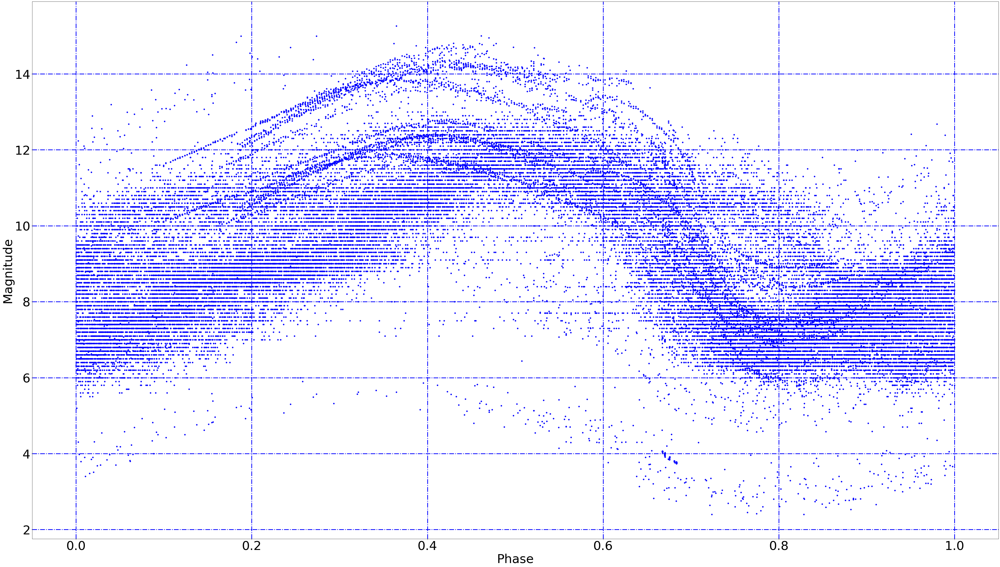

In [37]:
%matplotlib inline
plt.figure(figsize=(70, 40))
#plt.plot(newdfMirap["Phase"],newdfMirap["Magnitude"], 'k.', markersize=15)
plt.plot(newdfUorii["Phase"],newdfUorii["Magnitude"], 'k.', markersize=10, color="blue")
plt.xlabel('Phase',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

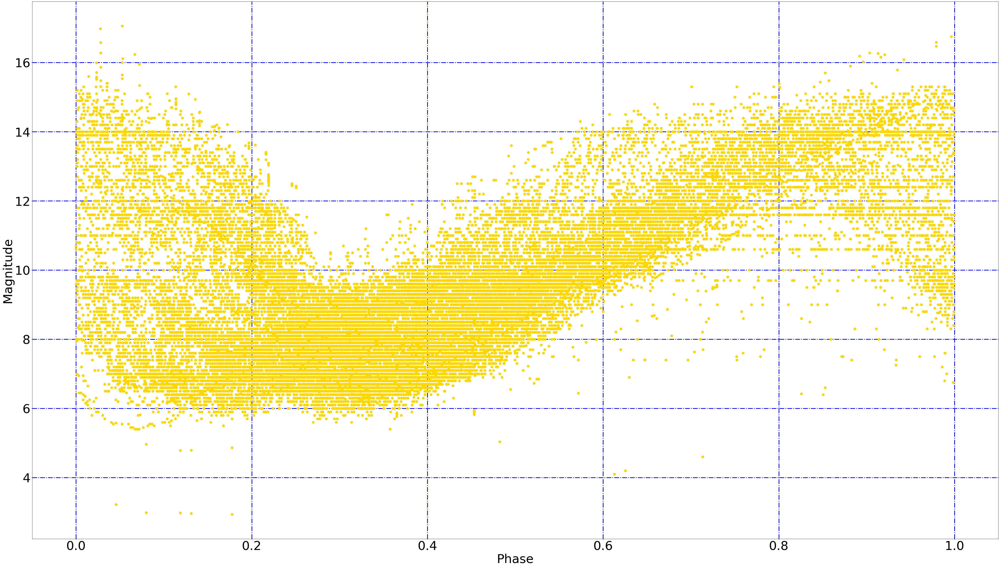

In [38]:
%matplotlib inline
plt.figure(figsize=(70, 40))
#plt.plot(newdfMirap["Phase"],newdfMirap["Magnitude"], 'k.', markersize=15)
plt.plot(newdfAndd["Phase"],newdfAndd["Magnitude"], 'k.', markersize=20, color="gold")
plt.xlabel('Phase',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

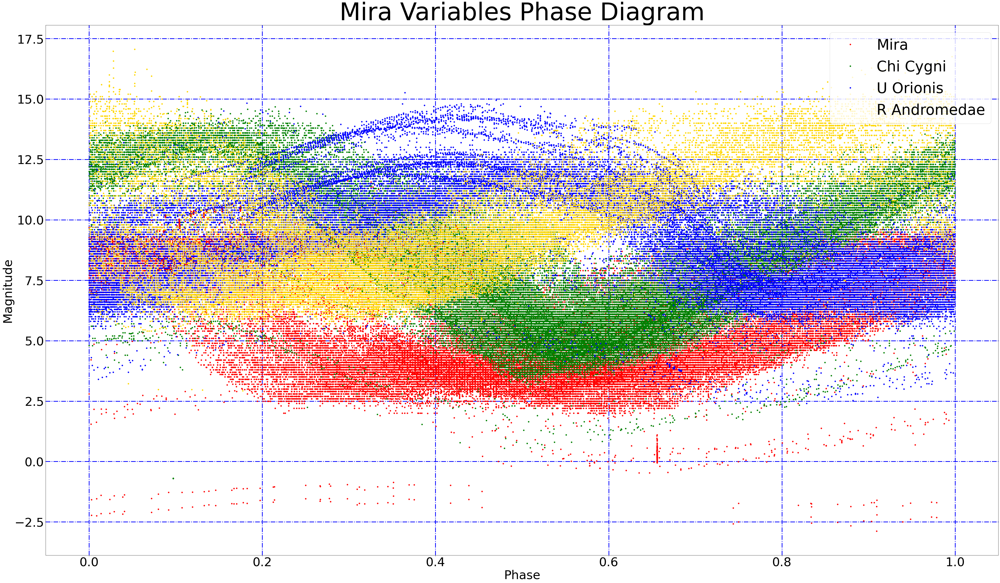

In [39]:
%matplotlib inline
plt.figure(figsize=(70, 40))
plt.plot(newdfMirap["Phase"],newdfMirap["Magnitude"], 'k.',label="Mira", markersize=10, color="red")
plt.plot(newdfChii["Phase"],newdfChii["Magnitude"], 'k.',label="Chi Cygni", markersize=10, color="green")
plt.plot(newdfUorii["Phase"],newdfUorii["Magnitude"], 'k.',label="U Orionis",markersize=10, color="blue")
plt.plot(newdfAndd["Phase"],newdfAndd["Magnitude"], 'k.',label="R Andromedae", markersize=10, color="gold")
plt.legend(loc="upper right",fontsize=60)
plt.xlabel('Phase',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.title("Mira Variables Phase Diagram", fontsize=100)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

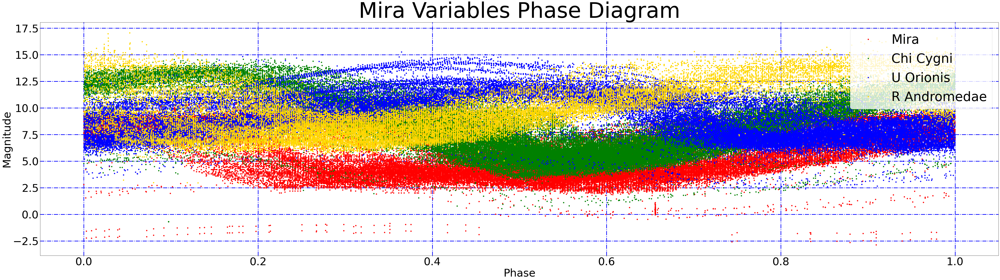

In [40]:
%matplotlib inline
plt.figure(figsize=(80, 20))
plt.plot(newdfMirap["Phase"],newdfMirap["Magnitude"], 'k.',label="Mira", markersize=10, color="red")
plt.plot(newdfChii["Phase"],newdfChii["Magnitude"], 'k.',label="Chi Cygni", markersize=10, color="green")
plt.plot(newdfUorii["Phase"],newdfUorii["Magnitude"], 'k.',label="U Orionis",markersize=10, color="blue")
plt.plot(newdfAndd["Phase"],newdfAndd["Magnitude"], 'k.',label="R Andromedae", markersize=10, color="gold")
plt.legend(loc="upper right",fontsize=60)
plt.xlabel('Phase',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.title("Mira Variables Phase Diagram", fontsize=100)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

In [41]:
time2=filter1(dfMira,2447400)
time2=phase(time2,332)
time3=filter1(dfUori,2447400)
time3=phase(time3,372.4)
time4=filter1(dfChi,2447400)
time4=phase(time4,408)
time5=filter1(dfAnd,2447400)
time5=phase(time5,409)

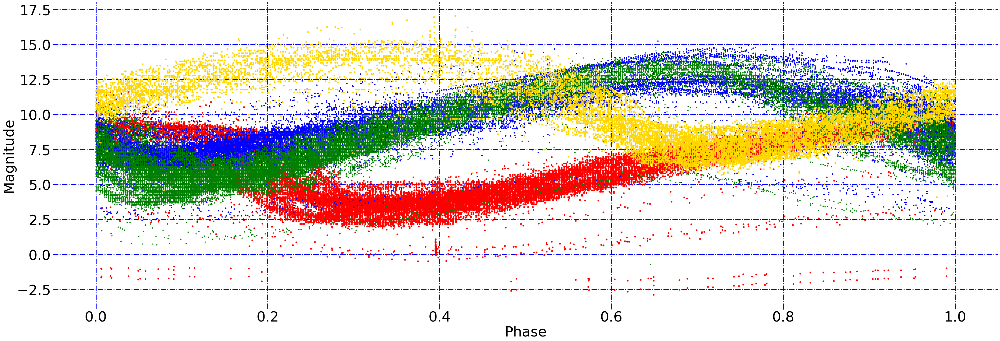

In [42]:
%matplotlib inline
plt.figure(figsize=(60, 20))
plt.plot(time2["Phase"],time2["Magnitude"], 'k.', markersize=10, color="red")
plt.plot(time3["Phase"],time3["Magnitude"], 'k.', markersize=8, color="blue")
plt.plot(time4["Phase"],time4["Magnitude"], 'k.', markersize=7, color="green")
plt.plot(time5["Phase"],time5["Magnitude"], 'k.', markersize=10, color="gold")
plt.xlabel('Phase',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

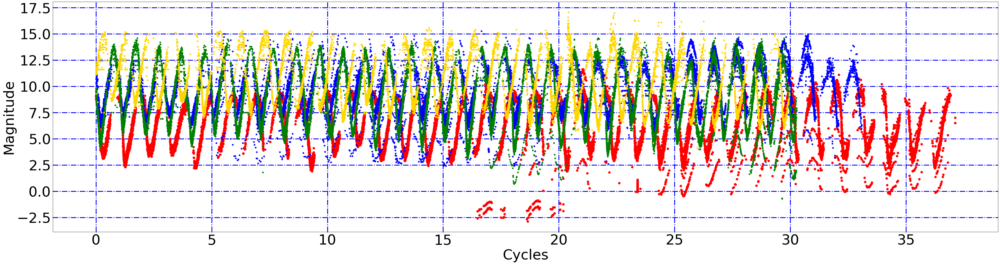

In [43]:
%matplotlib inline
plt.figure(figsize=(60, 15))
plt.plot(time2["Cycles"],time2["Magnitude"], 'k.', markersize=15, color="red")
plt.plot(time3["Cycles"],time3["Magnitude"], 'k.', markersize=10, color="blue")
plt.plot(time4["Cycles"],time4["Magnitude"], 'k.', markersize=10, color="green")
plt.plot(time5["Cycles"],time5["Magnitude"], 'k.', markersize=10, color="gold")
plt.xlabel('Cycles',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

## Common Timeline behaviour (Approach 1)

In [44]:
newdfMira=filter2(dfMira,2420000,2460000)
print("count for Mira : %.0f"%len(dfMira))
newdfUori=filter2(dfUori,2420000,2460000)
print("count for Uori : %.0f"%len(dfUori))
newdfChi=filter2(dfChi,2420000,2460000)
print("count for Chi : %.0f"%len(newdfChi))
newdfAnd=filter2(dfAnd,2420000,2460000)
print("count for And : %.0f"%len(dfAnd))

count for Mira : 80806
count for Uori : 52071
count for Chi : 83624
count for And : 33787


## Hyper parameter tuning using ANN

In [45]:
# for Mira period is 332
# for Uori period is 372.4 
# for Chi Cygni period is 408
# for R Andromedea period is 409

In [46]:
red_mira=dfMira[:33787]
red_Uori=dfUori[:33787]
red_Chi=dfChi[:33787]
red_And=dfAnd[:33787]
newdfa=pd.DataFrame()

In [47]:
newdfa["Magnitude"]=(red_mira["Magnitude"]+red_Uori["Magnitude"]+red_Chi["Magnitude"]+red_And["Magnitude"])/4
newdfa["JD"]=(red_mira["JD"]+dfUori["JD"]+red_Uori["JD"]+dfAnd["JD"])/4
newdfa["Uncertainty"]=(red_mira["Uncertainty"]+red_Uori["Uncertainty"]+red_Chi["Uncertainty"]+red_And["Uncertainty"])/4
newdfa=phase(newdfa,380.35)
newdfa

,Magnitude,JD,Uncertainty,Difference in days Tn - Tn-1,Difference in days,Cycles,Phase
0,6.1525,2.382149e+06,0.018500,0.000000,0.000000,0.000000,0.000000
1,6.1025,2.383297e+06,0.018500,1148.255000,1148.255000,3.018943,0.018943
2,6.9600,2.383438e+06,0.018500,140.920000,1289.175000,3.389444,0.389444
3,6.3300,2.386208e+06,0.018500,2769.790000,4058.965000,10.671658,0.671658
4,6.7450,2.386230e+06,0.018500,22.210000,4081.175000,10.730051,0.730051
...,...,...,...,...,...,...,...
33782,8.4925,2.451902e+06,0.036439,0.051215,69752.676672,183.390763,0.390763
33783,7.9000,2.451907e+06,0.036444,5.328328,69758.005000,183.404772,0.404772
33784,8.4250,2.451911e+06,0.036450,4.370000,69762.375000,183.416261,0.416261
33785,8.3750,2.451914e+06,0.036455,2.728150,69765.103150,183.423434,0.423434


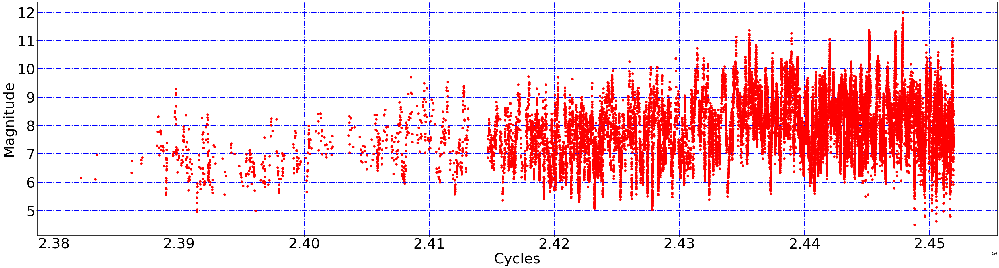

In [48]:
%matplotlib inline
plt.figure(figsize=(60, 15))
plt.plot(newdfa["JD"],newdfa["Magnitude"], 'k.', markersize=15, color="red")
plt.xlabel('Cycles',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

In [49]:
dfMira["JD_log"]=np.log(dfMira["JD"])

In [50]:
dfMira

,JD,Magnitude,Uncertainty,Difference in days Tn - Tn-1,Difference in days,Cycles,Phase,JD_log
0,2.304222e+06,2.8,0.002,NaN,0.00000,0.000000,0.000000,14.650254
1,2.308781e+06,3.5,0.002,4559.00000,4559.00000,13.731928,0.731928,14.652230
2,2.308788e+06,3.5,0.002,7.00000,4566.00000,13.753012,0.753012,14.652233
3,2.319696e+06,3.5,0.002,10908.00000,15474.00000,46.608434,0.608434,14.656947
4,2.319752e+06,4.5,0.002,56.00000,15530.00000,46.777108,0.777108,14.656971
...,...,...,...,...,...,...,...,...
80801,2.459658e+06,9.2,0.130,10.00972,155435.63194,468.179614,0.179614,14.715533
80802,2.459660e+06,9.1,0.130,1.86806,155437.50000,468.185241,0.185241,14.715533
80803,2.459722e+06,7.0,0.130,62.35420,155499.85420,468.373055,0.373055,14.715559
80804,2.459724e+06,6.5,0.130,2.00000,155501.85420,468.379079,0.379079,14.715560


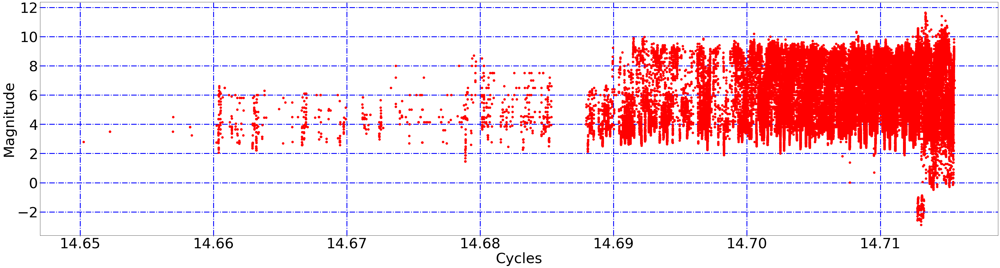

In [51]:
%matplotlib inline
plt.figure(figsize=(60, 15))
plt.plot(dfMira["JD_log"],dfMira["Magnitude"], 'k.', markersize=15, color="red")
plt.xlabel('Cycles',fontsize=50)
plt.ylabel('Magnitude',fontsize=50)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.grid(True)
plt.grid(color='b', ls = '-.', lw = 3)
plt.show()

# Probablistic model ( Neural networks and KNN) 
Extremes or in Quasi Equillibrium state ?

In [52]:
print(np.quantile(dfMira["Magnitude"],0.8))
print(np.quantile(dfMira["Magnitude"],0.2))

8.18
3.73


In [53]:
quant(newdfa)
quant(dfMira)

,JD,Magnitude,Uncertainty,Difference in days Tn - Tn-1,Difference in days,Cycles,Phase,JD_log,Pulsation State
0,2.304222e+06,2.8,0.002,NaN,0.00000,0.000000,0.000000,14.650254,1.0
1,2.308781e+06,3.5,0.002,4559.00000,4559.00000,13.731928,0.731928,14.652230,0.0
2,2.308788e+06,3.5,0.002,7.00000,4566.00000,13.753012,0.753012,14.652233,0.0
3,2.319696e+06,3.5,0.002,10908.00000,15474.00000,46.608434,0.608434,14.656947,0.0
4,2.319752e+06,4.5,0.002,56.00000,15530.00000,46.777108,0.777108,14.656971,0.0
...,...,...,...,...,...,...,...,...,...
80801,2.459658e+06,9.2,0.130,10.00972,155435.63194,468.179614,0.179614,14.715533,1.0
80802,2.459660e+06,9.1,0.130,1.86806,155437.50000,468.185241,0.185241,14.715533,1.0
80803,2.459722e+06,7.0,0.130,62.35420,155499.85420,468.373055,0.373055,14.715559,0.0
80804,2.459724e+06,6.5,0.130,2.00000,155501.85420,468.379079,0.379079,14.715560,0.0


In [54]:
dfMira["Pulsation State"].value_counts()

0.0    63154
1.0    17652
Name: Pulsation State, dtype: int64

In [55]:
dfMira

,JD,Magnitude,Uncertainty,Difference in days Tn - Tn-1,Difference in days,Cycles,Phase,JD_log,Pulsation State
0,2.304222e+06,2.8,0.002,NaN,0.00000,0.000000,0.000000,14.650254,1.0
1,2.308781e+06,3.5,0.002,4559.00000,4559.00000,13.731928,0.731928,14.652230,0.0
2,2.308788e+06,3.5,0.002,7.00000,4566.00000,13.753012,0.753012,14.652233,0.0
3,2.319696e+06,3.5,0.002,10908.00000,15474.00000,46.608434,0.608434,14.656947,0.0
4,2.319752e+06,4.5,0.002,56.00000,15530.00000,46.777108,0.777108,14.656971,0.0
...,...,...,...,...,...,...,...,...,...
80801,2.459658e+06,9.2,0.130,10.00972,155435.63194,468.179614,0.179614,14.715533,1.0
80802,2.459660e+06,9.1,0.130,1.86806,155437.50000,468.185241,0.185241,14.715533,1.0
80803,2.459722e+06,7.0,0.130,62.35420,155499.85420,468.373055,0.373055,14.715559,0.0
80804,2.459724e+06,6.5,0.130,2.00000,155501.85420,468.379079,0.379079,14.715560,0.0


### USING GRID SEARCH METHOD

In [56]:
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.wrappers.scikit_learn import KerasClassifier

x = dfMira.loc[:,['JD','Magnitude']]
y = dfMira.loc[:,['Pulsation State']]
from sklearn.model_selection import train_test_split
X_Train, X_val, Y_Train, Y_val = train_test_split(x, y, test_size=0.20, random_state=150)
score_acc = make_scorer(accuracy_score)

In [57]:
def DL_Model(activation= 'linear', neurons= 5, optimizer='Adam'):
    model = Sequential()
    model.add(Dense(neurons, input_dim= 2, activation= activation))
    model.add(Dense(neurons, activation= activation))
    model.add(Dropout(0.3))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='categorical_crossentropy', optimizer= optimizer, metrics=['accuracy'])
    return model

In [58]:
# Defining grid parameters
activation = ['relu', 'sigmoid', 'softplus', 'softsign', 'tanh', 'selu','elu', 'exponential', LeakyReLU,'relu']
neurons = [5, 100]
optimizer = ['SGD', 'Adam', 'RMSprop', 'Adadelta', 'Adagrad', 'Adamax', 'Nadam', 'Ftrl','SGD']
param_grid = dict(activation = activation, neurons = neurons, optimizer = optimizer)

clf = KerasClassifier(build_fn= DL_Model, epochs= 5, batch_size=1024, verbose= 2)

In [59]:
model = GridSearchCV(estimator= clf, param_grid=param_grid, n_jobs=-1)
model.fit(X_Train,Y_Train)

Epoch 1/5
64/64 - 0s - loss: nan - accuracy: 0.7816 - 486ms/epoch - 8ms/step
Epoch 2/5
64/64 - 0s - loss: nan - accuracy: 0.7816 - 85ms/epoch - 1ms/step
Epoch 3/5
64/64 - 0s - loss: nan - accuracy: 0.7816 - 74ms/epoch - 1ms/step
Epoch 4/5
64/64 - 0s - loss: nan - accuracy: 0.7816 - 90ms/epoch - 1ms/step
Epoch 5/5
64/64 - 0s - loss: nan - accuracy: 0.7816 - 75ms/epoch - 1ms/step


GridSearchCV(estimator=<keras.wrappers.scikit_learn.KerasClassifier object at 0x000002AE9B525A00>,
             n_jobs=-1,
             param_grid={'activation': ['relu', 'sigmoid', 'softplus',
                                        'softsign', 'tanh', 'selu', 'elu',
                                        'exponential',
                                        'relu'],
                         'neurons': [5, 100],
                         'optimizer': ['SGD', 'Adam', 'RMSprop', 'Adadelta',
                                       'Adagrad', 'Adamax', 'Nadam', 'Ftrl',
                                       'SGD']})

In [60]:
print("Max Accuracy Registred: {} using {}".format(round(model.best_score_,3), 
                                                   model.best_params_))

Max Accuracy Registred: 0.782 using {'activation': 'relu', 'neurons': 5, 'optimizer': 'SGD'}


In [61]:
prediction_test = model.predict(X_val)
print(confusion_matrix(Y_val,prediction_test))
print(classification_report(Y_val,prediction_test))
accuracy_ANN = accuracy_score(Y_val,prediction_test)

[[12627     0]
 [ 3535     0]]
              precision    recall  f1-score   support

         0.0       0.78      1.00      0.88     12627
         1.0       0.00      0.00      0.00      3535

    accuracy                           0.78     16162
   macro avg       0.39      0.50      0.44     16162
weighted avg       0.61      0.78      0.69     16162



### USING BAYESIAN METHOD

In [111]:
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import train_test_split


x = dfMira.loc[:,['JD','Magnitude']]
y = dfMira.loc[:,['Pulsation State']]
X_train, X_val, y_train, Y_val = train_test_split(x, y, test_size=0.30, random_state=150)
score_acc = make_scorer(accuracy_score)

In [112]:
score_acc = make_scorer(accuracy_score)

In [113]:
# Create function
def hyperpara_func(neurons, activation, optimizer, learning_rate,  batch_size, epochs ):
    optimizerL = ['SGD', 'Adam', 'RMSprop', 'Adadelta', 'Adagrad', 'Adamax', 'Nadam', 'Ftrl','SGD']
    optimizerD= {'Adam':Adam(lr=learning_rate), 'SGD':SGD(lr=learning_rate),
                 'RMSprop':RMSprop(lr=learning_rate), 'Adadelta':Adadelta(lr=learning_rate),
                 'Adagrad':Adagrad(lr=learning_rate), 'Adamax':Adamax(lr=learning_rate),
                 'Nadam':Nadam(lr=learning_rate), 'Ftrl':Ftrl(lr=learning_rate)}
    activationL = ['relu', 'sigmoid', 'softplus', 'softsign', 'tanh', 'selu',
                   'elu', 'exponential', LeakyReLU,'relu']
    neurons = round(neurons)
    activation = activationL[round(activation)]
    batch_size = round(batch_size)
    epochs = round(epochs)
    def nn_func():
        opt = Adam(lr = learning_rate)
        nn = Sequential()
        nn.add(Dense(neurons, input_dim=2, activation=activation))
        nn.add(Dense(neurons, activation=activation))
        nn.add(Dense(1, activation='sigmoid'))
        nn.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
        return nn
    
    Early_stopping = EarlyStopping(monitor='accuracy', mode='max', verbose=0, patience=20)
    nn = KerasClassifier(build_fn=nn_func, epochs=epochs, batch_size=batch_size,
                         verbose=0)
    kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=150)
    score = cross_val_score(nn, X_train, y_train, scoring=score_acc, cv=kfold, fit_params={'callbacks':[Early_stopping]}).mean()
    return score

In [114]:
# Set paramaters
neuralnetworks_parameters ={
    'neurons': (5, 100),
    'activation':(0, 9),
    'optimizer':(0,7),
    'learning_rate':(0.01, 1),
    'batch_size':(10, 1000),
    'epochs':(10, 100)
}
# Run Bayesian Optimization
try:
    nn_bo = BayesianOptimization(hyperpara_func, neuralnetworks_parameters, random_state=150)
    nn_bo.maximize(init_points=10, n_iter=4)
except TypeError:
    pass

|   iter    |  target   | activa... | batch_... |  epochs   | learni... |  neurons  | optimizer |
-------------------------------------------------------------------------------------------------
|  1        |  0.5562   |  8.177    |  265.4    |  88.99    |  0.7416   |  71.32    |  3.62     |
|  2        |  0.7812   |  8.569    |  914.5    |  17.04    |  0.7845   |  15.8     |  4.486    |
|  3        |  0.7812   |  0.7179   |  239.6    |  44.74    |  0.2444   |  99.85    |  2.725    |
|  4        |  0.7812   |  6.515    |  457.2    |  52.92    |  0.5498   |  46.12    |  4.128    |
|  5        |  0.7812   |  0.9447   |  862.5    |  37.72    |  0.4918   |  24.96    |  4.341    |
|  6        |  0.7812   |  3.072    |  499.6    |  37.66    |  0.4234   |  77.22    |  0.2866   |
|  7        |  0.5562   |  4.499    |  814.6    |  56.83    |  0.4372   |  75.18    |  5.2      |
|  8        |  0.7812   |  7.928    |  982.7    |  29.79    |  0.1024   |  18.84    |  2.876    |
|  9        |  0.668

In [115]:
neuralnetworks_parameters_ = nn_bo.max['params']
activationL = ['relu', 'sigmoid', 'softplus', 'softsign', 'tanh', 'selu',
               'elu', 'exponential', LeakyReLU,'relu']
neuralnetworks_parameters_['activation'] = activationL[round(neuralnetworks_parameters_['activation'])]
neuralnetworks_parameters_

{'activation': 'relu',
 'batch_size': 914.5080744884981,
 'epochs': 17.035702388479883,
 'learning_rate': 0.7844973233650819,
 'neurons': 15.7982105749287,
 'optimizer': 4.485949432180361}

In [116]:
# Create function
def layer_func(neurons, activation, optimizer, learning_rate, batch_size, epochs,
              layers1, layers2, normalization, dropout, dropout_rate):
    optimizerL = ['SGD', 'Adam', 'RMSprop', 'Adadelta', 'Adagrad', 'Adamax', 'Nadam', 'Ftrl','SGD']
    optimizerD= {'Adam':Adam(lr=learning_rate), 'SGD':SGD(lr=learning_rate),
                 'RMSprop':RMSprop(lr=learning_rate), 'Adadelta':Adadelta(lr=learning_rate),
                 'Adagrad':Adagrad(lr=learning_rate), 'Adamax':Adamax(lr=learning_rate),
                 'Nadam':Nadam(lr=learning_rate), 'Ftrl':Ftrl(lr=learning_rate)}
    activationL = ['relu', 'sigmoid', 'softplus', 'softsign', 'tanh', 'selu',
                   'elu', 'exponential', LeakyReLU,'relu']
    neurons = round(neurons)
    activation = activationL[round(activation)]
    optimizer = optimizerD[optimizerL[round(optimizer)]]
    batch_size = round(batch_size)
    epochs = round(epochs)
    layers1 = round(layers1)
    layers2 = round(layers2)
    def nn_func():
        nn = Sequential()
        nn.add(Dense(neurons, input_dim=2, activation=activation))
        if normalization > 0.5:
            nn.add(BatchNormalization())
        for i in range(layers1):
            nn.add(Dense(neurons, activation=activation))
        if dropout > 0.5:
            nn.add(Dropout(dropout_rate, seed=123))
        for i in range(layers2):
            nn.add(Dense(neurons, activation=activation))
        nn.add(Dense(1, activation='sigmoid'))
        nn.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])
        return nn
    Early_stopping = EarlyStopping(monitor='accuracy', mode='max', verbose=0, patience=20)
    nn = KerasClassifier(build_fn=nn_func, epochs=epochs, batch_size=batch_size, verbose=0)
    kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=150)
    score = cross_val_score(nn, X_train, y_train, scoring=score_acc, cv=kfold, fit_params={'callbacks':[Early_stopping]}).mean()
    return score

In [117]:
neuralnetworks_parameters2 ={
    'neurons': (5, 100),
    'activation':(0, 9),
    'optimizer':(0,7),
    'learning_rate':(0.01, 1),
    'batch_size':(10, 1000),
    'epochs':(10, 100),
    'layers1':(1,3),
    'layers2':(1,3),
    'normalization':(0,1),
    'dropout':(0,1),
    'dropout_rate':(0,0.3)
}
# Run Bayesian Optimization
try:
    nn_bo = BayesianOptimization(layer_func, neuralnetworks_parameters2, random_state=150)
    nn_bo.maximize(init_points=10, n_iter=4)
except TypeError:
    pass

|   iter    |  target   | activa... | batch_... |  dropout  | dropou... |  epochs   |  layers1  |  layers2  | learni... |  neurons  | normal... | optimizer |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        |  0.6948   |  8.177    |  265.4    |  0.8777   |  0.2217   |  72.83    |  2.034    |  2.904    |  0.9145   |  12.43    |  0.7823   |  0.7957   |
|  2        |  0.6687   |  5.768    |  88.97    |  0.232    |  0.1158   |  31.31    |  2.997    |  1.779    |  0.7266   |  47.92    |  0.4769   |  3.817    |
|  3        |  0.6687   |  3.895    |  593.8    |  0.105    |  0.2583   |  37.72    |  1.973    |  1.42     |  0.6239   |  37.43    |  0.4946   |  2.151    |
|  4        |  0.7812   |  3.758    |  762.6    |  0.04094  |  0.15     |  83.14    |  2.041    |  1.863    |  0.7413   |  75.57    |  0.8808   |  6.878    |
|  5        |  0.7812   |  1.979    |  102.4    |  0

In [118]:
neuralnetworks_parameters_ = nn_bo.max['params']
learning_rate = neuralnetworks_parameters_['learning_rate']
activationL = ['relu', 'sigmoid', 'softplus', 'softsign', 'tanh', 'selu',
               'elu', 'exponential', LeakyReLU,'relu']
neuralnetworks_parameters_['activation'] = activationL[round(neuralnetworks_parameters_['activation'])]
neuralnetworks_parameters_['batch_size'] = round(neuralnetworks_parameters_['batch_size'])
neuralnetworks_parameters_['epochs'] = round(neuralnetworks_parameters_['epochs'])
neuralnetworks_parameters_['layers1'] = round(neuralnetworks_parameters_['layers1'])
neuralnetworks_parameters_['layers2'] = round(neuralnetworks_parameters_['layers2'])
neuralnetworks_parameters_['neurons'] = round(neuralnetworks_parameters_['neurons'])
optimizerL = ['Adam', 'SGD', 'RMSprop', 'Adadelta', 'Adagrad', 'Adamax', 'Nadam', 'Ftrl','Adam']
optimizerD= {'Adam':Adam(lr=learning_rate), 'SGD':SGD(lr=learning_rate),
             'RMSprop':RMSprop(lr=learning_rate), 'Adadelta':Adadelta(lr=learning_rate),
             'Adagrad':Adagrad(lr=learning_rate), 'Adamax':Adamax(lr=learning_rate),
             'Nadam':Nadam(lr=learning_rate), 'Ftrl':Ftrl(lr=learning_rate)}
neuralnetworks_parameters_['optimizer'] = optimizerD[optimizerL[round(neuralnetworks_parameters_['optimizer'])]]
neuralnetworks_parameters_

{'activation': 'tanh',
 'batch_size': 763,
 'dropout': 0.04094062978063273,
 'dropout_rate': 0.14996006254263095,
 'epochs': 83,
 'layers1': 2,
 'layers2': 2,
 'learning_rate': 0.7413050601868744,
 'neurons': 76,
 'normalization': 0.88084374904289,
 'optimizer': <keras.optimizer_v2.ftrl.Ftrl at 0x2aea9975d90>}

In [119]:
# Fitting Neural Network
def nn_func():
    nn = Sequential()
    nn.add(Dense(neuralnetworks_parameters_['neurons'], input_dim=2, activation=neuralnetworks_parameters_['activation']))
    if neuralnetworks_parameters_['normalization'] > 0.5:
        nn.add(BatchNormalization())
    for i in range(neuralnetworks_parameters_['layers1']):
        nn.add(Dense(neuralnetworks_parameters_['neurons'], activation=neuralnetworks_parameters_['activation']))
    if neuralnetworks_parameters_['dropout'] > 0.5:
        nn.add(Dropout(neuralnetworks_parameters_['dropout_rate'], seed=123))
    for i in range(neuralnetworks_parameters_['layers2']):
        nn.add(Dense(neuralnetworks_parameters_['neurons'], activation=neuralnetworks_parameters_['activation']))
    nn.add(Dense(1, activation='sigmoid'))
    nn.compile(loss='binary_crossentropy', optimizer=neuralnetworks_parameters_['optimizer'], metrics=['accuracy'])
    return nn
        
Early_stopping = EarlyStopping(monitor='accuracy', mode='max', verbose=0, patience=20)
nn = KerasClassifier(build_fn=nn_func, epochs=neuralnetworks_parameters_['epochs'], batch_size=neuralnetworks_parameters_['batch_size'],
                         verbose=0)
 
history=nn.fit(X_train, y_train, validation_data=(X_val, Y_val), verbose=1)
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs=neuralnetworks_parameters_['epochs']
epochs_range = range(epochs)

Epoch 1/83
75/75 [==============================] - 2s 11ms/step - loss: 0.6906 - accuracy: 0.7812 - val_loss: 0.6890 - val_accuracy: 0.7823
Epoch 2/83
75/75 [==============================] - 1s 8ms/step - loss: 0.6880 - accuracy: 0.7812 - val_loss: 0.6870 - val_accuracy: 0.7823
Epoch 3/83
75/75 [==============================] - 1s 8ms/step - loss: 0.6863 - accuracy: 0.7812 - val_loss: 0.6855 - val_accuracy: 0.7823
Epoch 4/83
75/75 [==============================] - 1s 8ms/step - loss: 0.6849 - accuracy: 0.7812 - val_loss: 0.6843 - val_accuracy: 0.7823
Epoch 5/83
75/75 [==============================] - 1s 8ms/step - loss: 0.6838 - accuracy: 0.7812 - val_loss: 0.6832 - val_accuracy: 0.7823
Epoch 6/83
75/75 [==============================] - 1s 8ms/step - loss: 0.6827 - accuracy: 0.7812 - val_loss: 0.6822 - val_accuracy: 0.7823
Epoch 7/83
75/75 [==============================] - 1s 8ms/step - loss: 0.6818 - accuracy: 0.7812 - val_loss: 0.6813 - val_accuracy: 0.7823
Epoch 8/83
75/75 [=

Training Accuracy : 0.781239 
Validation Accuracy : 0.782279 


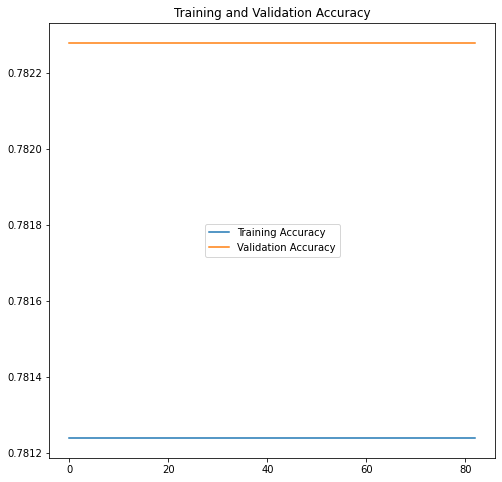

In [120]:
print("Training Accuracy : %f "% acc[-1])
print("Validation Accuracy : %f "% val_acc[-1])
plt.figure(figsize=(8, 8))
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')
#plt.plot(epochs_range, loss, label='Training Loss')
#plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='center')
plt.title('Training and Validation Accuracy')
plt.show()

# K-Nearest Neighbours (KNN)

In [73]:
newdfa=quant1(newdfa)
newdfa

,Magnitude,JD,Uncertainty,Difference in days Tn - Tn-1,Difference in days,Cycles,Phase,Pulsation State,State
0,6.1525,2.382149e+06,0.018500,0.000000,0.000000,0.000000,0.000000,1.0,Maxima/Minima
1,6.1025,2.383297e+06,0.018500,1148.255000,1148.255000,3.018943,0.018943,1.0,Maxima/Minima
2,6.9600,2.383438e+06,0.018500,140.920000,1289.175000,3.389444,0.389444,0.0,Quasi equillibrium
3,6.3300,2.386208e+06,0.018500,2769.790000,4058.965000,10.671658,0.671658,1.0,Maxima/Minima
4,6.7450,2.386230e+06,0.018500,22.210000,4081.175000,10.730051,0.730051,0.0,Quasi equillibrium
...,...,...,...,...,...,...,...,...,...
33782,8.4925,2.451902e+06,0.036439,0.051215,69752.676672,183.390763,0.390763,0.0,Quasi equillibrium
33783,7.9000,2.451907e+06,0.036444,5.328328,69758.005000,183.404772,0.404772,0.0,Quasi equillibrium
33784,8.4250,2.451911e+06,0.036450,4.370000,69762.375000,183.416261,0.416261,0.0,Quasi equillibrium
33785,8.3750,2.451914e+06,0.036455,2.728150,69765.103150,183.423434,0.423434,0.0,Quasi equillibrium


In [74]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors = 3)

In [75]:
a,b = newdfa.loc[:,newdfa.columns != 'State'], newdfa.loc[:,'State']
knn.fit(a,b)
prediction = knn.predict(a)
print('Prediction: {}'.format(prediction))

Prediction: ['Maxima/Minima' 'Maxima/Minima' 'Maxima/Minima' ... 'Quasi equillibrium'
 'Quasi equillibrium' 'Quasi equillibrium']


In [76]:
# train test split
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(a,b,test_size = 0.3,random_state = 1)
knn = KNeighborsClassifier(n_neighbors = 3)
x,y = newdfa.loc[:,newdfa.columns != 'Uncertainty'], newdfa.loc[:,'Uncertainty']
knn.fit(x_train,y_train)
prediction = knn.predict(x_test)
#print('Prediction: {}'.format(prediction))
print('With KNN (K=3) accuracy is: ',knn.score(x_test,y_test)) # accuracy

With KNN (K=3) accuracy is:  0.9317352273848278


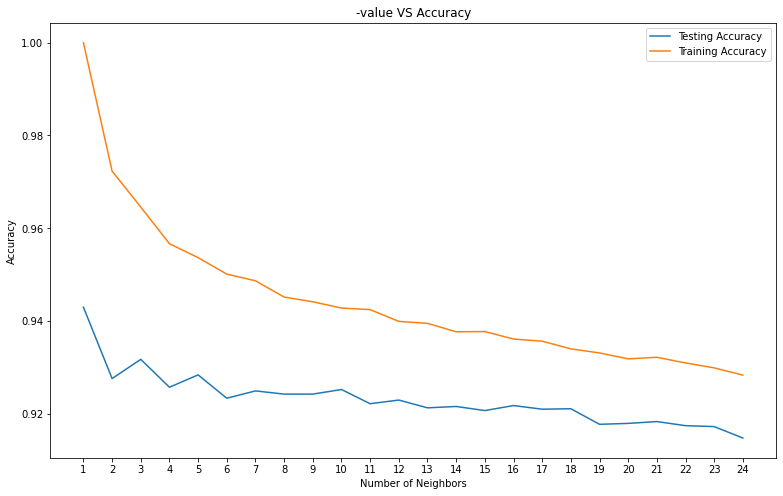

Best accuracy is 0.9429811581335701 with K = 1


In [77]:
# Model complexity
neig = np.arange(1, 25)
train_accuracy = []
test_accuracy = []
# Loop over different values of k
for i, k in enumerate(neig):
    # k from 1 to 25(exclude)
    knn = KNeighborsClassifier(n_neighbors=k)
    # Fit with knn
    knn.fit(x_train,y_train)
    #train accuracy
    train_accuracy.append(knn.score(x_train, y_train))
    # test accuracy
    test_accuracy.append(knn.score(x_test, y_test))

# Plot
plt.figure(figsize=[13,8])
plt.plot(neig, test_accuracy, label = 'Testing Accuracy')
plt.plot(neig, train_accuracy, label = 'Training Accuracy')
plt.legend()
plt.title('-value VS Accuracy')
plt.xlabel('Number of Neighbors')
plt.ylabel('Accuracy')
plt.xticks(neig)
plt.savefig('graph.png')
plt.show()
print("Best accuracy is {} with K = {}".format(np.max(test_accuracy),1+test_accuracy.index(np.max(test_accuracy))))

In [78]:
# based on the graph above best accuracy is achieved at n_neighbors: K = 1

# Predictive Models

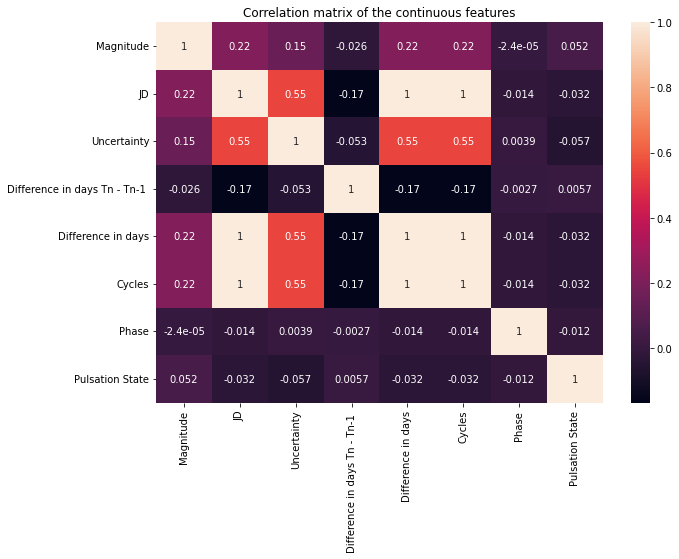

In [79]:
cont_features = ['Magnitude', 'JD', 'Uncertainty', 'Difference in days Tn - Tn-1 ',
       'Difference in days', 'Cycles', 'Phase', 'Pulsation State']

df1 = newdfa[cont_features]
corr=df1.corr()

plt.figure(figsize=(10,7))
sns.heatmap(corr,
            xticklabels=df1.columns,
            yticklabels=df1.columns,
           annot=True)
plt.title('Correlation matrix of the continuous features')
plt.show()

# 1. Linear Regression (Single input , x)

In [80]:
x = np.array(newdfa[['JD']]).reshape(-1,1)
y = np.array(newdfa['Uncertainty']).reshape(-1,1)

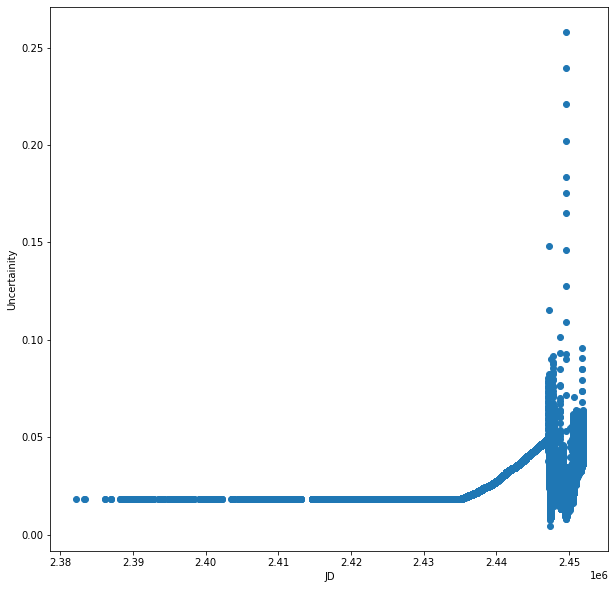

In [81]:
# Scatter
plt.figure(figsize=[10,10])
plt.scatter(x=x,y=y)
plt.xlabel('JD')
plt.ylabel('Uncertainity')
plt.show()

R^2 score:  0.2994167204799404


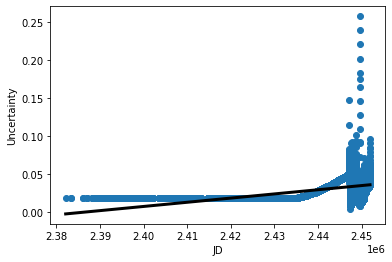

In [82]:
# LinearRegression
from sklearn.linear_model import LinearRegression
reg = LinearRegression()
# Predict space
predict_space = np.linspace(min(x), max(x)).reshape(-1,1)
# Fit
reg.fit(x,y)
# Predict
predicted = reg.predict(predict_space)
# R^2 
print('R^2 score: ',reg.score(x, y))
# Plot regression line and scatter
plt.plot(predict_space, predicted, color='black', linewidth=3)
plt.scatter(x=x,y=y)
plt.xlabel('JD')
plt.ylabel('Uncertainty')
plt.show()

# 2. Linear Regression (Multi input , x)

In [83]:
x = newdfa[['JD','Difference in days','Cycles','Magnitude']]
y = newdfa['Uncertainty']

In [84]:
from sklearn import linear_model

In [85]:
# importing train_test_split from sklearn
from sklearn.model_selection import train_test_split
# splitting the data
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 42)

In [86]:
regr = linear_model.LinearRegression()
regr.fit(x, y)

LinearRegression()

In [87]:
y_prediction =  regr.predict(x_test)
y_prediction

array([0.01670456, 0.02973938, 0.03359604, ..., 0.02274323, 0.03321075,
       0.0329895 ])

In [88]:
# importing r2_score module
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(y_test,y_prediction)
print("r2 socre is ",score)
print("mean_sqrd_error is==",mean_squared_error(y_test,y_prediction))
print("root_mean_squared error of is==",np.sqrt(mean_squared_error(y_test,y_prediction)))

r2 socre is  0.30106533972564486
mean_sqrd_error is== 8.283230367105623e-05
root_mean_squared error of is== 0.009101225393926701


# 3. Decision Tree Regression

In [89]:
X = newdfa[['JD','Difference in days','Cycles','Magnitude']]
Y = newdfa['Uncertainty']

In [90]:
# Splitting the dataset into 80% training data and 20% testing data.
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=.20, random_state=0)

In [91]:
#Building the Decision Tree Model on our dataset
from sklearn.tree import DecisionTreeRegressor
DT_model = DecisionTreeRegressor(max_depth=5).fit(X_train,Y_train)
DT_predict = DT_model.predict(X_test) #Predictions on Testing data
print(DT_predict)

[0.03301411 0.02850254 0.03132349 ... 0.04639401 0.01850038 0.01548272]


In [92]:
# importing r2_score module
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(Y_test,DT_predict)
print("r2 socre is ",score)
print("mean_sqrd_error is==",mean_squared_error(Y_test,DT_predict))
print("root_mean_squared error of is==",np.sqrt(mean_squared_error(Y_test,DT_predict)))

r2 socre is  0.8426620077212292
mean_sqrd_error is== 1.812814392822566e-05
root_mean_squared error of is== 0.004257715811115822


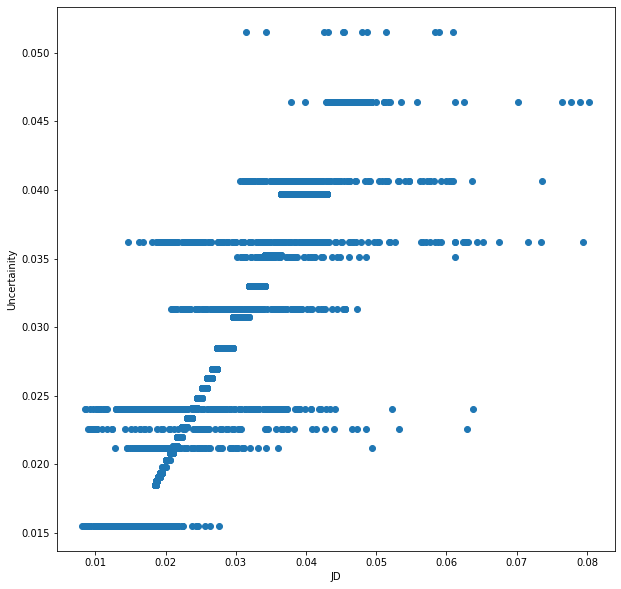

In [93]:
# Scatter
plt.figure(figsize=[10,10])
plt.scatter(x=Y_test,y=DT_predict)
plt.xlabel('JD')
plt.ylabel('Uncertainity')
plt.show()

# KNN Regressor

In [94]:
from sklearn.neighbors import KNeighborsRegressor
KNN_model = KNeighborsRegressor(n_neighbors=3).fit(X_train,Y_train)
KNN_predict = KNN_model.predict(X_test) #Predictions on Testing data
print(KNN_predict)

[0.03191257 0.02807276 0.0227267  ... 0.04594031 0.0185     0.01237752]


In [95]:
# importing r2_score module
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(Y_test,KNN_predict)
print("r2 socre is ",score)
print("mean_sqrd_error is==",mean_squared_error(Y_test,KNN_predict))
print("root_mean_squared error of is==",np.sqrt(mean_squared_error(Y_test,KNN_predict)))

r2 socre is  0.9794340173120994
mean_sqrd_error is== 2.3695681430273535e-06
root_mean_squared error of is== 0.0015393401648197689


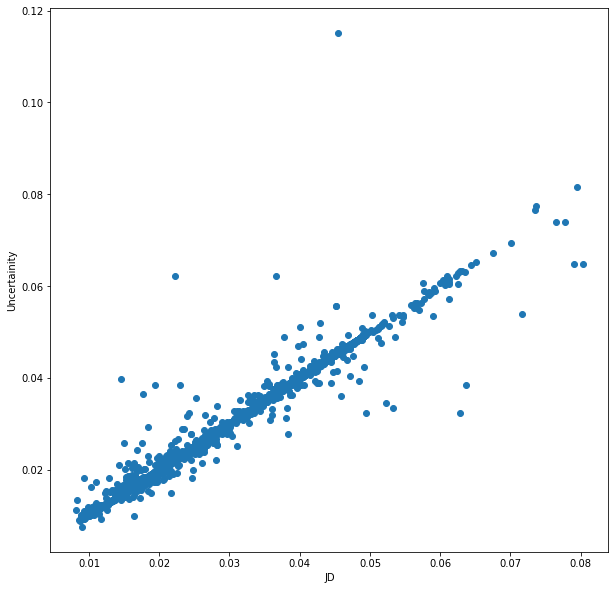

In [105]:
# Scatter
plt.figure(figsize=[10,10])
plt.scatter(x=Y_test,y=KNN_predict)
plt.xlabel('JD')
plt.ylabel('Uncertainity')
plt.show()